<a href="https://colab.research.google.com/github/Rishabh690/White_blood_cell_classification-/blob/main/white_blood_cell_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import random
from PIL import Image
from PIL import ImageOps
from PIL import ImageEnhance
import joblib
from torchvision import transforms
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
import xgboost as xgb
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.preprocessing import LabelEncoder


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!unzip /content/drive/MyDrive/task.zip

Archive:  /content/drive/MyDrive/task.zip
   creating: classify-images/
  inflating: classify-images/15.jpg  
  inflating: classify-images/16.jpg  
  inflating: classify-images/17.jpg  
  inflating: classify-images/12.jpg  
  inflating: classify-images/3.jpg   
  inflating: classify-images/5.jpg   
  inflating: classify-images/6.jpg   
  inflating: classify-images/20.jpg  
  inflating: classify-images/22.jpg  
  inflating: classify-images/26.jpg  
  inflating: classify-images/27.jpg  
  inflating: classify-images/29.jpg  
  inflating: classify-images/30.jpg  
  inflating: classify-images/32.jpg  
  inflating: classify-images/34.jpg  
  inflating: classify-images/36.jpg  
  inflating: classify-images/38.jpg  
  inflating: classify-images/1.jpg   
  inflating: classify-images/2.jpg   
  inflating: classify-images/4.jpg   
  inflating: classify-images/10.jpg  
  inflating: classify-images/8.jpg   
  inflating: classify-images/9.jpg   
  inflating: classify-images/11.jpg  
  inflating: cla

In [4]:
# Set the path to the main folder containing the subfolders with images
main_folder = "/content/wbc"

# Iterate through each subfolder
for folder_name in os.listdir(main_folder):
    folder_path = os.path.join(main_folder, folder_name)

    # Skip non-folder files
    if not os.path.isdir(folder_path):
        continue

    # Get the list of images in the subfolder
    images = os.listdir(folder_path)

    # Check if the subfolder contains at least one image
    if len(images) > 0:
        # Select the first image from the subfolder
        image_name = images[0]
        image_path = os.path.join(folder_path, image_name)

        # Open the image
        image = Image.open(image_path)

        # Get the size of the image
        image_size = image.size

        # Print the size
        print("Image Size:", image_size)

        # Close the image
        image.close()

print("Image size retrieval completed successfully.")


Image Size: (256, 256)
Image Size: (256, 256)
Image Size: (256, 256)
Image Size: (256, 256)
Image Size: (256, 256)
Image Size: (256, 256)
Image Size: (256, 256)
Image Size: (256, 256)
Image Size: (256, 256)
Image size retrieval completed successfully.


# Printing random images of each type

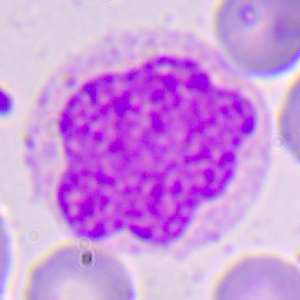

Type: metamyelocytes



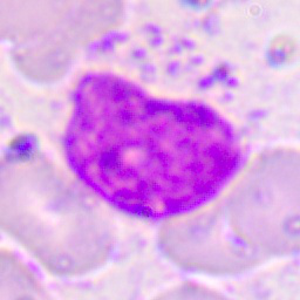

Type: myelocytes



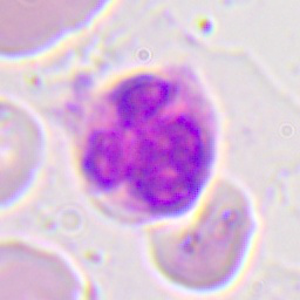

Type: neutrophils



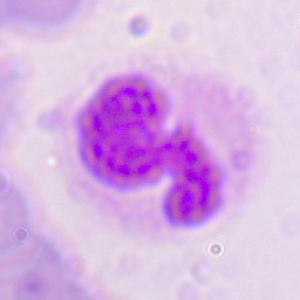

Type: bands



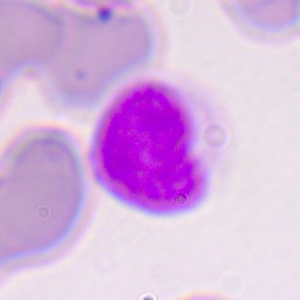

Type: lymphocytes



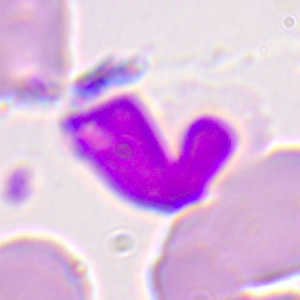

Type: blasts



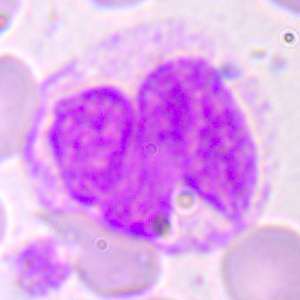

Type: monocytes



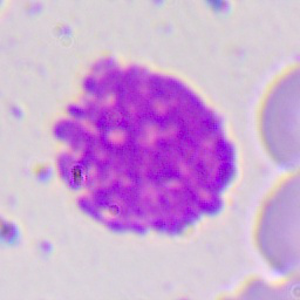

Type: basophils



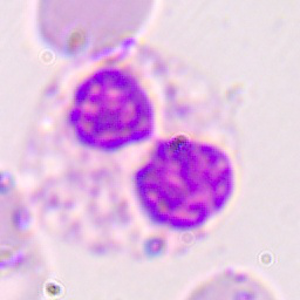

Type: eosinophils



In [5]:
# Specify the path to the main folder
main_folder = '/content/wbc'

# Get the list of subfolders (types) within the main folder
subfolders = [subfolder for subfolder in os.listdir(main_folder) if os.path.isdir(os.path.join(main_folder, subfolder))]


# Iterate over each subfolder
for subfolder in subfolders:
    subfolder_path = os.path.join(main_folder, subfolder)

    # Get the list of image files within the subfolder
    image_files = [image for image in os.listdir(subfolder_path) if image.endswith('.jpg')]

    # Randomly select an image from the subfolder
    random_image = random.choice(image_files)

    # Load the selected image
    image_path = os.path.join(subfolder_path, random_image)
    image = Image.open(image_path)

    # Resize the image to a larger size
    larger_image = image.resize((300,300))  # Adjust the size as per your requirements
    # Show the larger image
    larger_image.show()
    # Print the type
    print("Type:", subfolder)
    print()


# bar plot to check if the data is balanced or not

Graph saved as 'image_counts_graph.png'


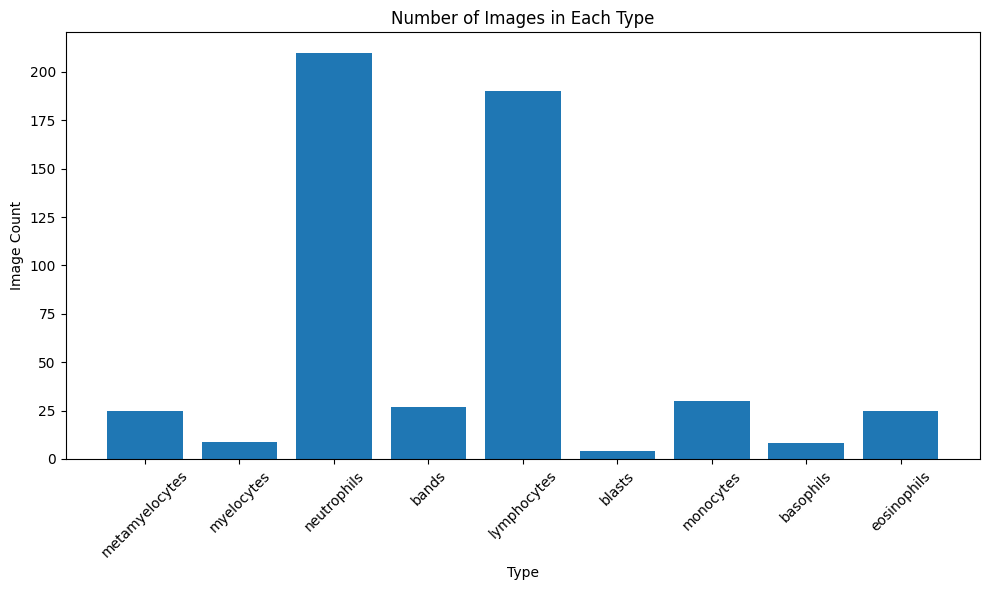

In [6]:
# Specify the path to the main folder
main_folder = '/content/wbc'

# Get the list of subfolders (types) within the main folder
subfolders = [subfolder for subfolder in os.listdir(main_folder) if os.path.isdir(os.path.join(main_folder, subfolder))]

# List to store the image counts for each type
image_counts = []

# Iterate over the subfolders
for subfolder in subfolders:
    subfolder_path = os.path.join(main_folder, subfolder)

    # Get the list of image files within the subfolder
    image_files = [image for image in os.listdir(subfolder_path) if image.endswith('.jpg')]

    # Count the number of images in the subfolder
    image_count = len(image_files)

    # Append the image count to the list
    image_counts.append(image_count)

# Plot the image counts as a bar graph
plt.figure(figsize=(10, 6))
plt.bar(subfolders, image_counts)
plt.xlabel("Type")
plt.ylabel("Image Count")
plt.title("Number of Images in Each Type")
plt.xticks(rotation=45)
plt.tight_layout()

# Save the graph as a PNG file
plt.savefig('image_counts_graph.png')

# Provide feedback to indicate successful saving of the graph
print("Graph saved as 'image_counts_graph.png'")


# With the help of the bar plot we can see that data is highly imbalance . SO now we have to use data augmentation technique to make the data balanced

In [7]:
# Set the path to the main folder containing the subfolders with images
main_folder = "/content/wbc"

# Set the desired number of images per folder
desired_images_per_folder = 300

# Define the augmentation techniques you want to apply
augmentation_techniques = [
    "rotation",
    "horizontal_flip",
    "vertical_flip",
    "brightness",
    "contrast"
]


In [8]:
def apply_augmentation(image):
    augmented_images = [image]

    if "rotation" in augmentation_techniques:
        angle = np.random.randint(-30, 30)
        augmented_images.append(image.rotate(angle))

    if "horizontal_flip" in augmentation_techniques:
        augmented_images.append(image.transpose(Image.FLIP_LEFT_RIGHT))

    if "vertical_flip" in augmentation_techniques:
        augmented_images.append(image.transpose(Image.FLIP_TOP_BOTTOM))

    if "brightness" in augmentation_techniques:
        factor = np.random.uniform(0.8, 1.2)
        augmented_images.append(ImageEnhance.Brightness(image).enhance(factor))

    if "contrast" in augmentation_techniques:
        factor = np.random.uniform(0.8, 1.2)
        augmented_images.append(ImageEnhance.Contrast(image).enhance(factor))

    return augmented_images


In [9]:
# Iterate through each subfolder
for folder_name in os.listdir(main_folder):
    folder_path = os.path.join(main_folder, folder_name)

    # Skip non-folder files
    if not os.path.isdir(folder_path):
        continue

    # Get the list of images in the subfolder
    images = os.listdir(folder_path)

    # Calculate the number of additional images needed
    num_images = len(images)
    additional_images_needed = desired_images_per_folder - num_images

    # Iterate until desired number of images is reached
    while additional_images_needed > 0:
        # Select a random image from the folder
        random_image = np.random.choice(images)
        image_path = os.path.join(folder_path, random_image)

        # Open the image
        image = Image.open(image_path)

        # Apply augmentation techniques
        augmented_images = apply_augmentation(image)

        # Save augmented images
        for augmented_image in augmented_images:
            # Generate a unique name for the augmented image
            augmented_image_name = random_image.replace(".jpg", f"_augmented_{additional_images_needed}.jpg")
            augmented_image_path = os.path.join(folder_path, augmented_image_name)

            # Save the augmented image
            augmented_image.save(augmented_image_path)

            additional_images_needed -= 1

            # Break the loop if desired number of images is reached
            if additional_images_needed <= 0:
                break

        # Close the original image
        image.close()

print("Data augmentation completed successfully.")


Data augmentation completed successfully.


Graph saved as 'augmented_image_counts_graph.png'


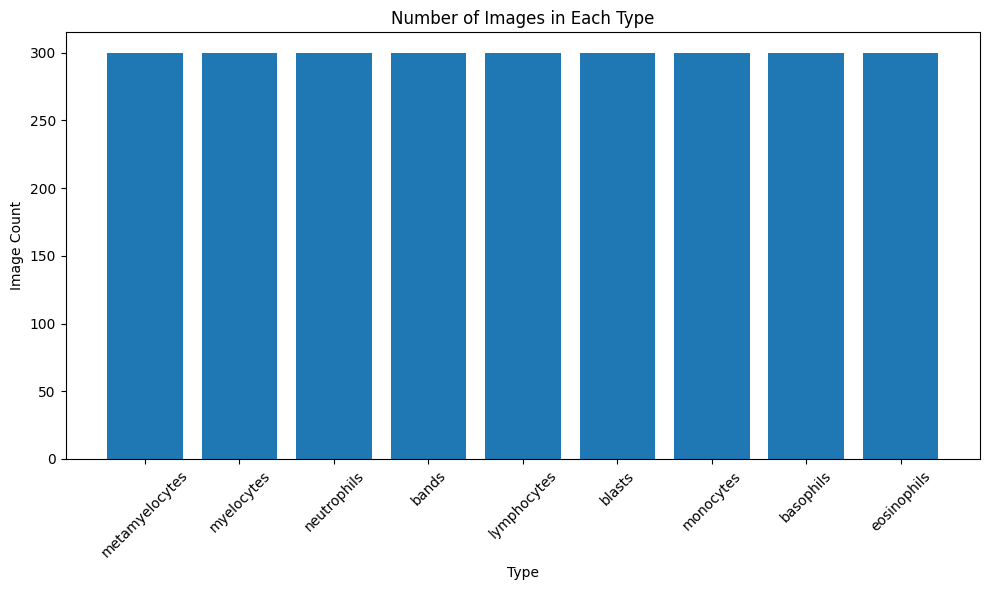

In [10]:
# Specify the path to the main folder
main_folder = '/content/wbc'

# Get the list of subfolders (types) within the main folder
subfolders = [subfolder for subfolder in os.listdir(main_folder) if os.path.isdir(os.path.join(main_folder, subfolder))]

# List to store the image counts for each type
image_counts = []

# Iterate over the subfolders
for subfolder in subfolders:
    subfolder_path = os.path.join(main_folder, subfolder)

    # Get the list of image files within the subfolder
    image_files = [image for image in os.listdir(subfolder_path) if image.endswith('.jpg')]

    # Count the number of images in the subfolder
    image_count = len(image_files)

    # Append the image count to the list
    image_counts.append(image_count)

# Plot the image counts as a bar graph
plt.figure(figsize=(10, 6))
plt.bar(subfolders, image_counts)
plt.xlabel("Type")
plt.ylabel("Image Count")
plt.title("Number of Images in Each Type")
plt.xticks(rotation=45)
plt.tight_layout()

# Save the graph as a PNG file
plt.savefig('augmented_image_counts_graph.png')

# Provide feedback to indicate successful saving of the graph
print("Graph saved as 'augmented_image_counts_graph.png'")


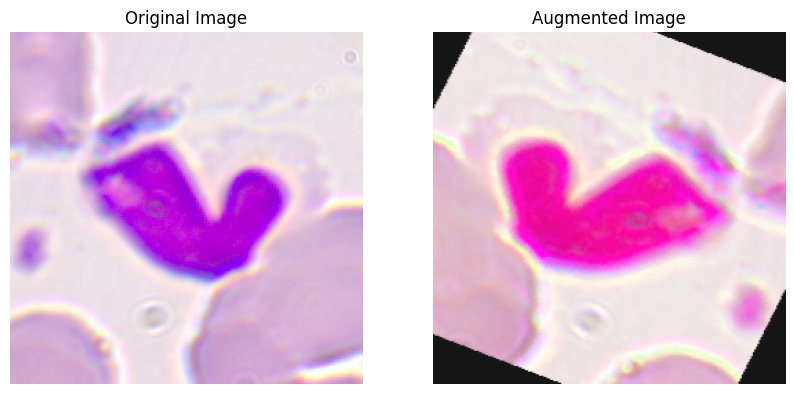

In [11]:
def augment_image(image_path):
    # Load the original image
    image = Image.open(image_path)

    # Define a list of augmentation transformations
    transform = transforms.Compose([
        transforms.RandomHorizontalFlip(),
        transforms.RandomRotation(30),
        transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
        transforms.RandomResizedCrop((image.size[1], image.size[0]), scale=(0.8, 1.2)),
        transforms.ToTensor()
    ])

    # Apply the transformations to the original image
    augmented_image = transform(image)

    # Convert the augmented image tensor to a PIL image
    augmented_image = transforms.ToPILImage()(augmented_image)

    return image, augmented_image

# Path to the original image
image_path = '/content/wbc/blasts/19_97_1708_304_256.jpg'

# Augment the image
original_image, augmented_image = augment_image(image_path)

# Display the images
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].imshow(original_image)
axs[0].set_title('Original Image')
axs[0].axis('off')
axs[1].imshow(augmented_image)
axs[1].set_title('Augmented Image')
axs[1].axis('off')

# Show the images
plt.show()


In [ ]:
def preprocess_image(img_path):
    img = Image.open(img_path)
    img = img.resize((224, 224))  # Assuming target size is 224x224
    img = np.array(img) / 255.0  # Normalize pixel values between 0 and 1
    return img

In [ ]:
def get_images_with_labels(root_folder):
    images = []
    labels = []

    for dirpath, dirnames, filenames in os.walk(root_folder):
        # Skip the root folder
        if dirpath == root_folder:
            continue

        label = os.path.basename(dirpath)

        for filename in filenames:
            if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                images.append(os.path.join(dirpath, filename))
                labels.append(label)

    return images, labels

# Set the root folder path
root_folder = 'wbc'

# Retrieve images and labels
images, labels = get_images_with_labels(root_folder)

Splitting the data into train test split

In [ ]:
# Split the data into train, validation, and test sets
train_images, test_images, train_labels, test_labels = train_test_split(images, labels, test_size=0.2, random_state=42)
train_images, val_images, train_labels, val_labels = train_test_split(train_images, train_labels, test_size=0.2, random_state=42)

In [ ]:
# Preprocess the training images
X_train = [preprocess_image(image_path) for image_path in train_images]
X_train = np.array(X_train)

# Flatten the feature vectors
X_train = X_train.reshape(X_train.shape[0], -1)

# Preprocess the validation images
X_val = [preprocess_image(image_path) for image_path in val_images]
X_val = np.array(X_val)

# Flatten the feature vectors
X_val = X_val.reshape(X_val.shape[0], -1)

# Preprocess the test images
X_test = [preprocess_image(image_path) for image_path in test_images]
X_test = np.array(X_test)

# Flatten the feature vectors
X_test = X_test.reshape(X_test.shape[0], -1)

# Random forest

In [ ]:


# Create an instance of the Random Forest classifier
random_forest = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the Random Forest classifier
random_forest.fit(X_train, train_labels)

# Predict the labels for the training data
train_predictions = random_forest.predict(X_train)

# Calculate the training accuracy
train_accuracy = accuracy_score(train_labels, train_predictions)
print(f"Training Accuracy: {train_accuracy}")

# Predict the labels for the validation data
val_predictions = random_forest.predict(X_val)

# Calculate the validation accuracy
val_accuracy = accuracy_score(val_labels, val_predictions)
print(f"Validation Accuracy: {val_accuracy}")

# Predict the labels for the test data
test_predictions = random_forest.predict(X_test)

# Calculate the test accuracy
test_accuracy = accuracy_score(test_labels, test_predictions)
print(f"Test Accuracy: {test_accuracy}")
joblib.dump(random_forest, 'random_forest_model.pkl')

Training Accuracy: 1.0
Validation Accuracy: 0.8586206896551725
Test Accuracy: 0.8729281767955801


['random_forest_model.pkl']

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
precision = precision_score(test_labels, test_predictions, average='weighted')
recall = recall_score(test_labels, test_predictions, average='weighted')
f1 = f1_score(test_labels, test_predictions, average='weighted')

print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"f1: {f1}")

Precision: 0.8744448208660155
Recall: 0.8729281767955801
f1: 0.8720589647417585


In [ ]:
def get_image_paths(folder_path):
    image_paths = []
    for dirpath, _, filenames in os.walk(folder_path):
        for filename in filenames:
            if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                image_paths.append(os.path.join(dirpath, filename))
    return image_paths

 # Making prediction of classify-images using Random forest

In [ ]:
# Set the test images folder path
test_folder = '/content/classify-images'

# Get the paths of test images
classify_test_image_paths = get_image_paths(test_folder)

# Preprocess the test images
X_test_classify = [preprocess_image(image_path) for image_path in classify_test_image_paths]
X_test_classify = np.array(X_test)

# Flatten the feature vectors
X_test_classify = X_test_classify.reshape(X_test.shape[0], -1)

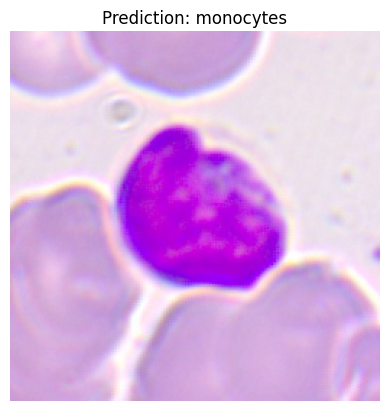

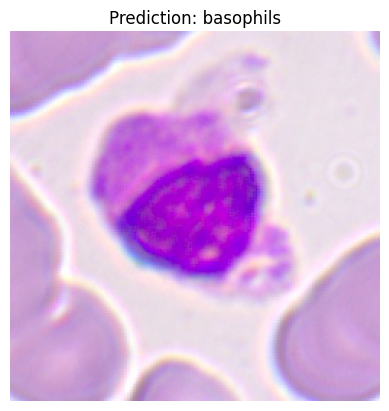

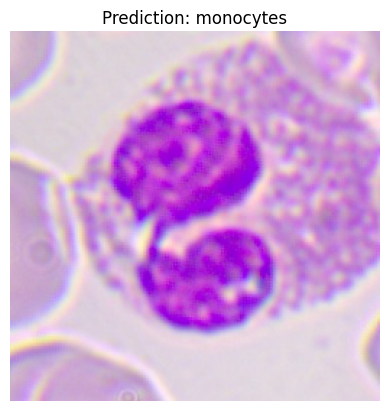

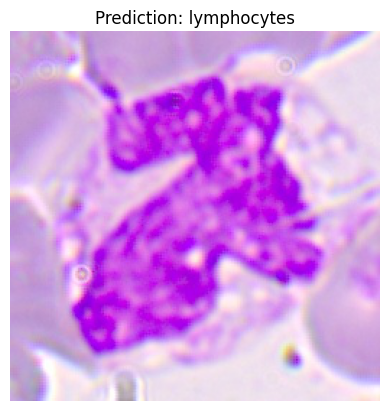

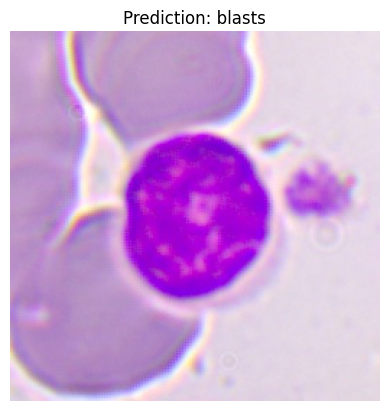

...

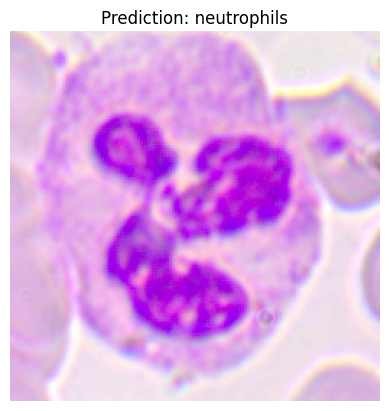

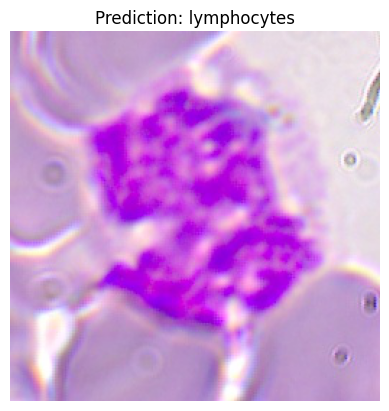

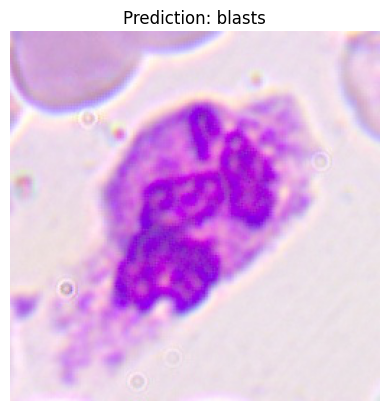

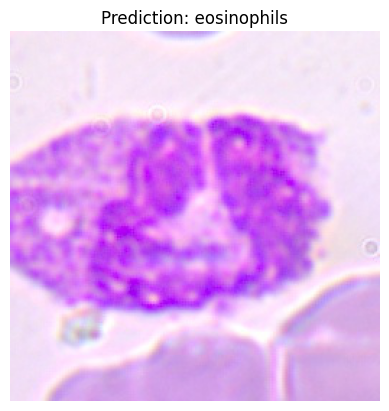

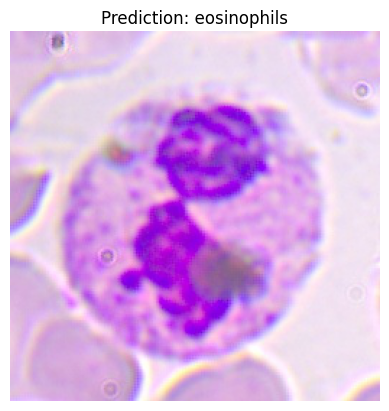

In [ ]:
# Load the trained Random Forest model
random_forest = joblib.load('/content/random_forest_model.pkl')  # Replace with the actual path to your saved model

# Predict the labels for the test images
classify_test_predictions = random_forest.predict(X_test_classify)

# Display the images along with the predicted labels
for image_path, prediction in zip(classify_test_image_paths, classify_test_predictions):
    img = Image.open(image_path)
    plt.imshow(img)
    plt.title(f"Prediction: {prediction}")
    plt.axis('off')
    plt.show()


# Support vector machine

In [ ]:

# Create an instance of the SVM classifier
svm = SVC(kernel='rbf', C=1.0, random_state=42)

# Train the SVM classifier
svm.fit(X_train, train_labels)

# Predict the labels for the training data
train_predictions = svm.predict(X_train)

# Calculate the training accuracy
train_accuracy = accuracy_score(train_labels, train_predictions)
print(f"Training Accuracy: {train_accuracy}")

# Predict the labels for the validation data
val_predictions = svm.predict(X_val)

# Calculate the validation accuracy
val_accuracy = accuracy_score(val_labels, val_predictions)
print(f"Validation Accuracy: {val_accuracy}")

# Predict the labels for the test data
test_predictions = svm.predict(X_test)

# Calculate the test accuracy
test_accuracy = accuracy_score(test_labels, test_predictions)
print(f"Test Accuracy: {test_accuracy}")



Training Accuracy: 0.9145077720207254
Validation Accuracy: 0.7655172413793103
Test Accuracy: 0.7707182320441989


In [ ]:
# Save the SVM model to a file
joblib.dump(svm, 'svm_model.pkl')


['svm_model.pkl']

In [ ]:

precision = precision_score(test_labels, test_predictions, average='weighted')
recall = recall_score(test_labels, test_predictions, average='weighted')
f1 = f1_score(test_labels, test_predictions, average='weighted')

print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"f1: {f1}")

Precision: 0.827418714633381
Recall: 0.8148148148148148
f1: 0.8168755482691568


# Making prediction of classify-images using Support vector machine

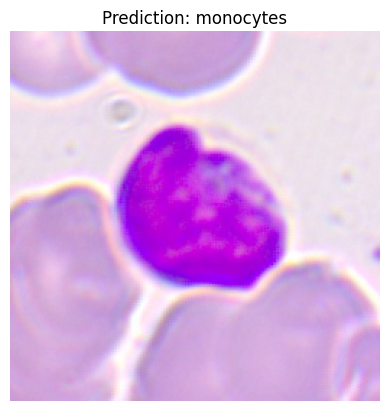

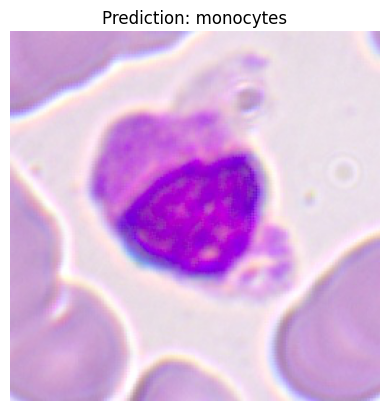

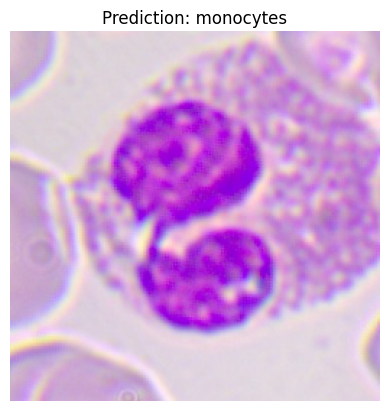

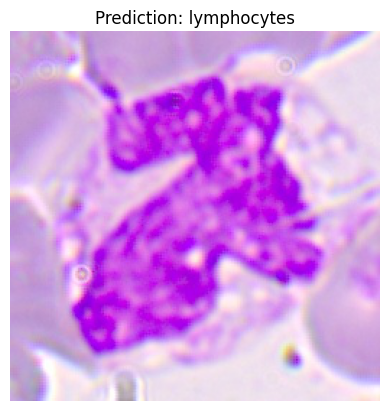

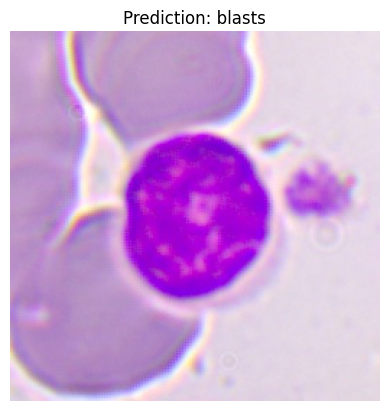

...

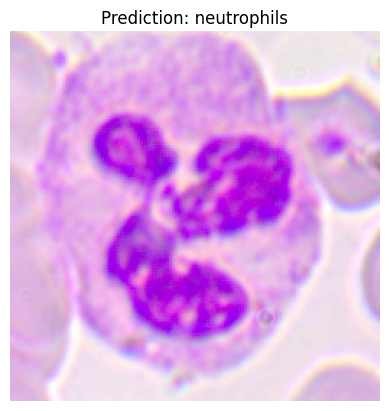

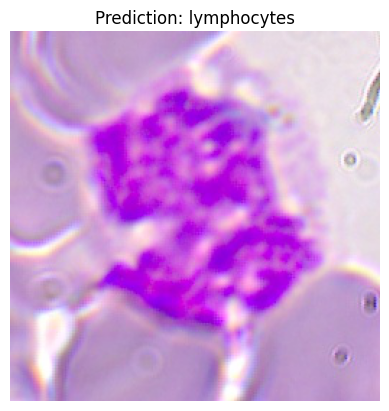

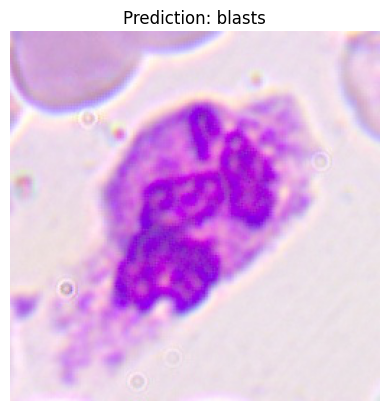

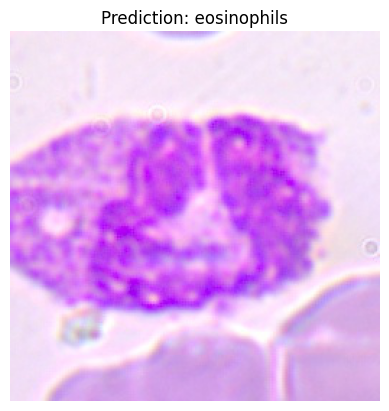

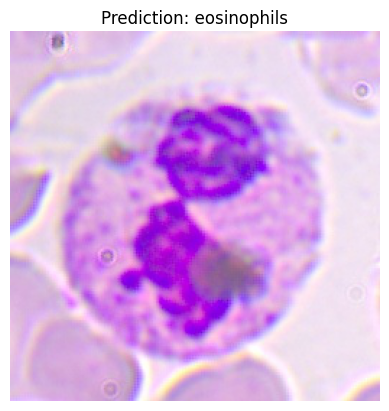

In [ ]:
# Load the trained SVM model
svm = joblib.load('/content/svm_model.pkl')  # Replace with the actual path to your saved model

# Predict the labels for the test images
classify_test_predictions = svm.predict(X_test_classify)

# Display the images along with the predicted labels
for image_path, prediction in zip(classify_test_image_paths, classify_test_predictions):
    img = Image.open(image_path)
    plt.imshow(img)
    plt.title(f"Prediction: {prediction}")
    plt.axis('off')
    plt.show()


# Xgboost model


In [ ]:
def preprocess_image(img_path):
    img = Image.open(img_path)
    img = img.resize((224, 224))  # Assuming target size is 224x224
    img = np.array(img) / 255.0  # Normalize pixel values between 0 and 1
    return img.flatten()

def get_images_with_labels(root_folder):
    images = []
    labels = []

    for dirpath, dirnames, filenames in os.walk(root_folder):
        # Skip the root folder
        if dirpath == root_folder:
            continue

        label = os.path.basename(dirpath)

        for filename in filenames:
            if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                images.append(os.path.join(dirpath, filename))
                labels.append(label)

    return images, labels

# Set the root folder path
root_folder = 'wbc'

# Retrieve images and labels
images, labels = get_images_with_labels(root_folder)

# Preprocess the images
X = [preprocess_image(image_path) for image_path in images]
X = np.array(X)

# Encode the labels as integers
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(labels)

# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Reshape the label data
y_train = y_train.reshape(-1, 1)
y_test = y_test.reshape(-1, 1)

# Create DMatrix for XGBoost
dtrain = xgb.DMatrix(X_train, label=y_train)
dtest = xgb.DMatrix(X_test, label=y_test)

# Define the parameters for XGBoost
params = {
    'objective': 'multi:softmax',  # Multiclass classification objective
    'num_class': len(np.unique(y)),  # Number of classes
    'max_depth': 6,
    'eta': 0.3,
    'subsample': 0.8,
    'colsample_bytree': 0.8,
}

# Train the XGBoost model
num_rounds = 100
model = xgb.train(params, dtrain, num_rounds)

# Predict the labels for the test data
test_predictions = model.predict(dtest)

# Convert predicted labels to integers
test_predictions = test_predictions.astype(int)

# Calculate the test accuracy
test_accuracy = accuracy_score(y_test, test_predictions)
print(f"Test Accuracy: {test_accuracy}")


Test Accuracy: 0.8545454545454545


In [ ]:
joblib.dump(model, 'xgboost.pkl')

['xgboost.pkl']

In [ ]:
precision = precision_score(y_test, test_predictions, average='weighted')
recall = recall_score(y_test, test_predictions, average='weighted')
f1 = f1_score(y_test, test_predictions, average='weighted')
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"f1: {f1}")

Precision: 0.8580495531545952
Recall: 0.8545454545454545
f1: 0.8543403315313325


# Making prediction of classify-images using Xgboost

In [ ]:
# Load the trained SVM model
xgboost = joblib.load('/content/xgboost.pkl')  # Replace with the actual path to your saved model

# Predict the labels for the test images
X_test_classify = xgb.DMatrix(X_test_classify)
classify_test_predictions = xgboost.predict(X_test_classify)

# Display the images along with the predicted labels
for image_path, prediction in zip(classify_test_image_paths, classify_test_predictions):
    img = Image.open(image_path)
    plt.imshow(img)
    plt.title(f"Prediction: {prediction}")
    plt.axis('off')
    plt.show()

/usr/local/lib/python3.10/dist-packages/xgboost/data.py:925: UserWarning: Unknown data type: <class 'xgboost.core.DMatrix'>, trying to convert it to csr_matrix
  warnings.warn(


TypeError: ignored

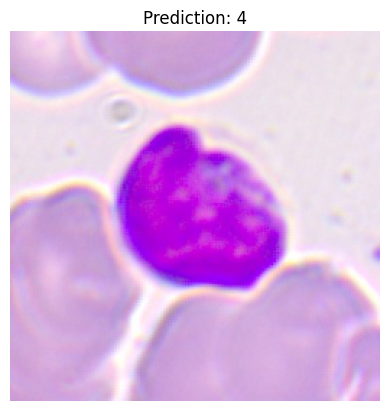

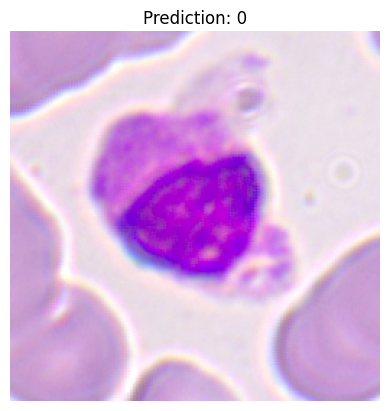

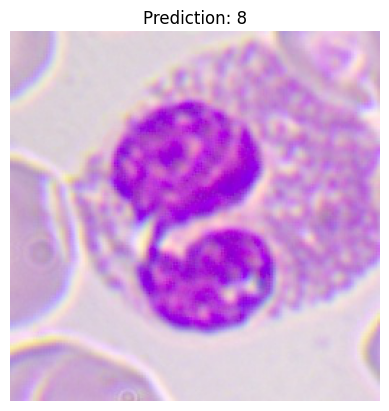

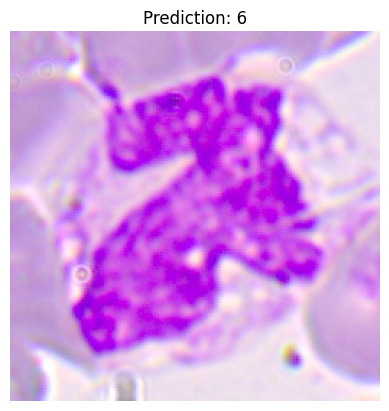

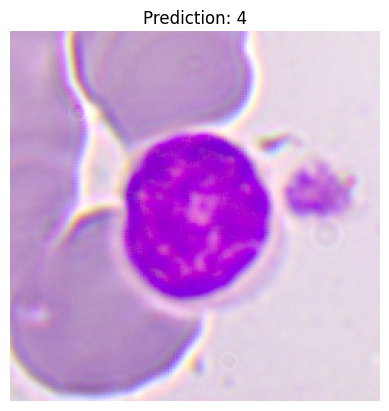

...

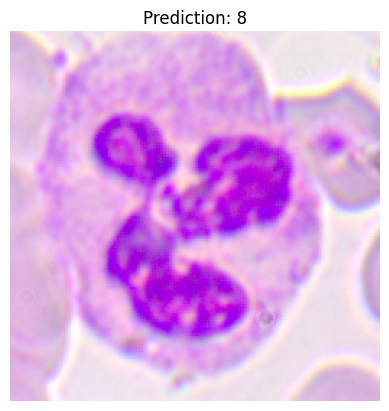

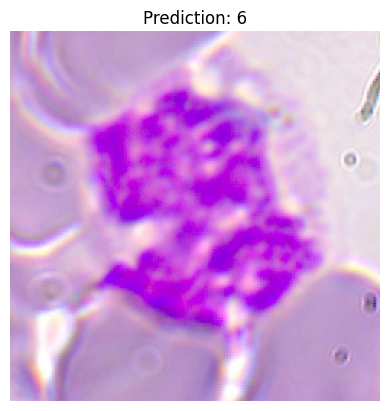

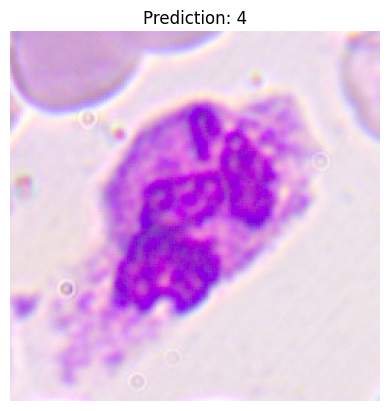

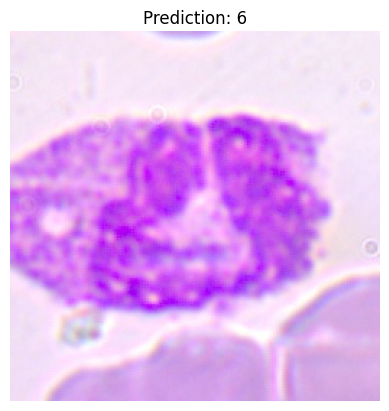

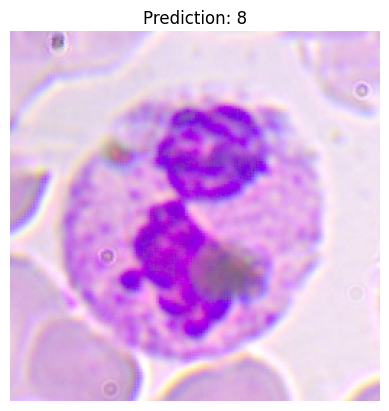

In [ ]:
test_folder = '/content/classify-images'

# Get the paths of test images
test_image_paths = get_image_paths(test_folder)

# Preprocess the test images
X_test_classify = [preprocess_image(image_path) for image_path in test_image_paths]
X_test_classify = np.array(X_test_classify)

# Load the trained XGBoost model
xgboost = joblib.load('/content/xgboost.pkl')  # Replace with the actual path to your saved model
dtest_classify = xgb.DMatrix(X_test_classify)

# Load the trained XGBoost model
xgboost = joblib.load('/content/xgboost.pkl')  # Replace with the actual path to your saved model

# Predict the class labels for the test images
classify_test_predictions = xgboost.predict(dtest_classify)

# Display the images along with the predicted labels
for image_path, prediction in zip(test_image_paths, classify_test_predictions):
    img = Image.open(image_path)
    plt.imshow(img)
    plt.title(f"Prediction: {int(prediction)}")
    plt.axis('off')
    plt.show()